---
title: Transforming workflow for oceanography study using Sentinel‑2 data, from SAFE to Zarr
subtitle: Computing wave spectra with 2D FFT & coherence in the EOPF framework

authors:
  - name: Tina Odaka
    orcid: 0000-0002-1500-0156
    github: tinaok
    affiliations:
      - id: IFREMER
        institution: IFREMER
        ror: 044jxhp58
  - name: Nicolas Rascle
    orcid: 0000-0001-9959-1119
    github: nrascle
    affiliations:
      - id: IFREMER
        institution: IFREMER
        ror: 044jxhp58
  - name: Anne Fouilloux
    orcid: 0000-0002-1784-2920
    github: annefou
    affiliations:
      - id: Simula Research Laboratory
        institution: Simula Research Laboratory
        ror: 00vn06n10
date: 2025-08-26
thumbnail: https://raw.githubusercontent.com/EOPF-Sample-Service/eopf-sample-notebooks/refs/heads/main/notebooks/static/ESA_logo_2020_Deep.png
keywords: ["oceanography", "wave analysis", "remote sensing"]
tags: ["marine", "xarray", "sentinel-2"]
releaseDate: 2025-08-26
datePublished: 2025-08-26
dateModified: 2025-08-26
github: https://github.com/EOPF-Sample-Service/eopf-sample-notebooks
license: Apache-2.0
---

```{image} ../static/ESA_EOPF_logo_2025_COLOR_ESA_blue_reduced.png
:alt: ESA EOPF Zarr Logo
:width: 250px
:align: center
```

## Table of contents

- [Introduction](#Intro_wave)
- [Setup](#Setup_wave)
- [Accessing Sentinel-2 Data in EOPF Zarr Format](#Read_wave)
- [Selecting a Region and Verifying Detector Consistency](#Select_wave)
- [Image Normalization and Whitecap Filtering](#Filter_wave)
- [Fourier Transform & Welch-Based Spectral Analysis](#Welch_wave)
- [🌊 Fourier and Cross-Spectral Analysis with angular metrics](#Cross_wave)
- [Summary](#Summary_wave)


(Intro_wave)=
## Introduction

This notebook demonstrates an improved workflow for oceanographic wave spectral analysis using Sentinel-2 data. We transition from the traditional SAFE format to the cloud-optimized EOPF Zarr format, highlighting substantial improvements in computational efficiency, simplicity, and scalability.

Original research workflow based on SAFE format is available at [this notebook](https://github.com/tinaok/eopf-webiner6/blob/main/SAFE_workflow.ipynb).

To understand the scientific background for the wave analysis methods used here, refer to:
[Kudryavtsev et al., 2016](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1002/2016JC012425).

This workflow leverages the new EOPF Zarr format, eliminating the cumbersome steps required for loading SAFE files, significantly simplifying data handling and computational processing.



:::{hint} Overview
**Questions**
- How can we perform wave spectral analysis using Sentinel-2 data in the EOPF framework?
- What preprocessing steps are essential for reliable wave detection using EOPF datasets?
- How do we implement 2D Fourier analysis for ocean wave characterization with EOPF ZARR data?
- What are the impacts of using EOPF's data structure for oceanographic applications?

**Objectives**
- Learn how to access and work with EOPF Sentinel-2 ZARR datasets as analysis-ready datacubes (ARDC)
- Understand the workflow differences when using EOPF ZARR format for oceanographic applications
- Create your own wave spectral analysis using Sentinel-2 L1C products within the EOPF framework
- Perform advanced wave spectral analysis techniques on Sentinel-2 data including 2D FFT and coherence analysis

:::

(Setup_wave)=
## Setup and Dependencies

This notebook requires several Python libraries for data access, analysis, and visualization:
- `xarray`, `hvplot`, `holoviews` for data access and visualization
- `pystac-client` to query the STAC API
- `dask.distributed` for scalable computation
- `numpy`, `matplotlib`, `skimage` for numerics and filtering

In the EOPF JupyterHub environment, these packages are preinstalled. For local development, you may need to install them.

```{tip}
We use **Bokeh** for interactive visualizations in this notebook, which provides zooming and panning capabilities ideal for exploring spectral data. For local development, you can switch to Matplotlib by uncommenting the relevant lines.

For plotting, you may choose between:
- **Bokeh** → interactive and dynamic visualizations
- **Matplotlib** → faster static plots
```

```{tip}
You can uncomment the lines with `cluster` and `client` to explicitly start a Dask `LocalCluster`.  
This allows you to observe live how Dask workers behave using the Dask JupyterLab extension.
```

In the next cell, we start by importing the core Python libraries required for wave analysis, visualization, and efficient handling of large xarray datasets.


In [1]:
import xarray as xr
import hvplot.xarray
import pystac_client
import holoviews as hv
import numpy as np
import matplotlib.pyplot as plt
import cmocean
from skimage.filters import sobel
import matplotlib.colors as mcolors

hvplot.extension("bokeh")
# hvplot.extension("matplotlib")  # Uncomment for local development
# %matplotlib inline               # Uncomment for Matplotlib backend

# Uncomment the following lines to explicitly start a Dask LocalCluster
# and observe live behavior in the Dask JupyterLab extension.
# from dask.distributed import Client, LocalCluster\n",
# cluster = LocalCluster()   # Start a local Dask cluster
# client = Client(cluster)   # Connect to the cluster

# If you use JupyterHub, the link to your Dask dashboard looks like:
# /user/your_username/proxy/8787/

(Read_wave)=
## Accessing Sentinel-2 Data in EOPF Zarr Format via STAC

We use the cloud-optimized EOPF Zarr format available through the [EOPF Sample Service](https://eopf-sample-service.github.io/eopf-sample-notebooks/stac-eopf-zarr-sentinel).


We search for Sentinel-2 data over the Bay of Biscay, an area known for consistent wave patterns. The search criteria are optimized for wave analysis:

- **Low cloud cover (< 20%)**: Ensures clear ocean surface visibility
- **High sun elevation** places the sun high above the horizon, near the zenith, increasing the likelihood of **specular reflection (sunglint)** off the water surface.
While sunglint often obscures features like water quality or bathymetry, it is sought after to detect waves, as it enhances the contrast of wave-induced brightness patterns on the images.
- **Ocean location**: Coordinates selected for open water conditions

```{note}
This notebook closely matches the geographic coordinates and time from the original SAFE workflow notebook to facilitate direct comparison.
```


In [2]:
# Access cloud-optimized Sentinel-2 data via the EOPF STAC catalog
catalog = pystac_client.Client.open("https://stac.core.eopf.eodc.eu")

# Define oceanographic study area and time window
LON, LAT = -4.5, 48  # Bay of Biscay - known for consistent wave patterns
date = "2025-06-17/2025-06-17"

# Search criteria optimized for wave analysis
collections = ["sentinel-2-l1c"]
items = list(
    catalog.search(
        datetime=date,
        collections=collections,
        intersects=dict(type="Point", coordinates=[LON, LAT]),
        query={
            "eo:cloud_cover": {
                "lt": 20
            },  # Cloud cover < 20% ensures clear ocean surface
            "view:sun_elevation": {
                "gt": 25
            },  # Filter for high sun elevation > 25° (→ sun zenith angle < 65°),
            # which places the sun near the zenith.
        },
    ).items()
)

for item in items:
    print(f"✅ {item.id}")
else:
    print("No items found for the given criteria.")

✅ S2B_MSIL1C_20250617T112109_N0511_R037_T30UUU_20250617T131418
No items found for the given criteria.


### Loading Sentinel-2 Data with xarray (EOPF Zarr)

The **EOPF Zarr** format exposes Sentinel-2 Level-1C (L1C) products as cloud-native, chunked arrays that xarray can read **lazily from object storage**. This avoids downloading full SAFE archives and makes large-scale exploration fast and memory-efficient.

For screening and context, we first open an **L1C** quicklook using `open_dataset` to confirm location and cloud conditions, then perform the detailed wave-spectrum analysis on **L1C** by opening it with `open_datatree`.

The EOPF backend is configured via `xarray:open_datatree_kwargs` on the STAC asset, with `engine="eopf-zarr"`. This tells xarray to stream the dataset directly from object storage.

**What the next cell does**
1. Selects the first STAC item (`items[0]`, an L1C product).  
2. (Optional) Prints the asset’s `extra_fields` so you can see the backend parameters being passed.  
3. Opens it with  
   `xr.open_dataset(item.assets["product"].href, **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"])`.  
4. Returns an `xarray.Dataset` where variables are available at the top level, loaded lazily.  
5. Visualizes the **L1C quicklook**.


```{tip}
**Visualization performance advantage with `hvplot(..., rasterize=True)`**  
With `hvplot(..., rasterize=True)`, the quicklook uses **Datashader** on the backend to aggregate data into a raster image and send only that image to the browser. This greatly improves performance on large datasets while preserving interactivity (pan/zoom; hover tooltips over aggregated pixels — for sampling underlying data, use the `selector` option).
```


```{note}
**Difference from SAFE workflow**  

This step replaces the custom GDAL/Rasterio scripts many SAFE-based workflows used to open JPEG2000 tiles and parse XML metadata, simplifying data access. Sentinel-2 SAFE products bundle JP2 imagery plus XML metadata.

As shown here, the quicklook visualisation step uses open-source **xarray** + **hvplot** with `rasterize=True` — no special, dataset-specific code required. Because the **EOPF Zarr** format follows established standards (**Zarr** and **STAC**), we can leverage general-purpose open-source tools instead of re-inventing the wheel.
```


In [3]:
# Extract the first item, e.g. Sentinel-2 L1C product
item = items[0]

# Inspect backend parameters
item.assets["product"].extra_fields

{'xarray:open_datatree_kwargs': {'chunks': {},
  'engine': 'eopf-zarr',
  'op_mode': 'native'}}

In [4]:
# Open the dataset lazily from object storage
l1c_ds = xr.open_dataset(
    item.assets["product"].href,
    **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
)

l1c_ds

<xarray.Dataset> Size: 7GB
Dimensions:                                            (
                                                        conditions_geometry_angle: 2,
                                                        conditions_geometry_band: 13,
                                                        conditions_geometry_y: 23,
                                                        conditions_geometry_x: 23,
                                                        conditions_geometry_detector: 7,
                                                        ...
                                                        quality_mask_r10m_y: 10980,
                                                        quality_mask_r10m_x: 10980,
                                                        quality_mask_r20m_y: 5490,
                                                        quality_mask_r20m_x: 5490,
                                                        quality_mask_r60m_y: 1830,
                                                        quality_mask_r60m_x: 1830)
Coordinates: (12/44)
  * conditions_geometry_angle                          (conditions_geometry_angle) <U7 56B ...
  * conditions_geometry_band                           (conditions_geometry_band) <U3 156B ...
  * conditions_geometry_detector                       (conditions_geometry_detector) int64 56B ...
  * conditions_geometry_x                              (conditions_geometry_x) int64 184B ...
  * conditions_geometry_y                              (conditions_geometry_y) int64 184B ...
  * conditions_mask_detector_footprint_r10m_x          (conditions_mask_detector_footprint_r10m_x) int64 88kB ...
    ...                                                 ...
  * quality_mask_r10m_x                                (quality_mask_r10m_x) int64 88kB ...
  * quality_mask_r10m_y                                (quality_mask_r10m_y) int64 88kB ...
  * quality_mask_r20m_x                                (quality_mask_r20m_x) int64 44kB ...
  * quality_mask_r20m_y                                (quality_mask_r20m_y) int64 44kB ...
  * quality_mask_r60m_x                                (quality_mask_r60m_x) int64 15kB ...
  * quality_mask_r60m_y                                (quality_mask_r60m_y) int64 15kB ...
Data variables: (12/62)
    conditions_geometry_mean_sun_angles                (conditions_geometry_angle) float64 16B dask.array<chunksize=(2,), meta=np.ndarray>
    conditions_geometry_mean_viewing_incidence_angles  (conditions_geometry_band, conditions_geometry_angle) float64 208B dask.array<chunksize=(13, 2), meta=np.ndarray>
    conditions_geometry_sun_angles                     (conditions_geometry_angle, conditions_geometry_y, conditions_geometry_x) float64 8kB dask.array<chunksize=(2, 23, 23), meta=np.ndarray>
    conditions_geometry_viewing_incidence_angles       (conditions_geometry_band, conditions_geometry_detector, conditions_geometry_angle, conditions_geometry_y, conditions_geometry_x) float64 770kB dask.array<chunksize=(7, 4, 2, 23, 23), meta=np.ndarray>
    conditions_mask_detector_footprint_r10m_b02        (conditions_mask_detector_footprint_r10m_y, conditions_mask_detector_footprint_r10m_x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
    conditions_mask_detector_footprint_r10m_b03        (conditions_mask_detector_footprint_r10m_y, conditions_mask_detector_footprint_r10m_x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
    ...                                                 ...
    quality_mask_r20m_b11                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
    quality_mask_r20m_b12                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
    quality_mask_r20m_b8a                              (quality_mask_r20m_y, quality_mask_r20m_x) uint8 30MB dask.array<chunks

In [5]:
# Quicklook visualization of the L1C product
l1c_plot = l1c_ds.quality_l1c_quicklook_tci.hvplot.rgb(
    x="quality_l1c_quicklook_x",
    y="quality_l1c_quicklook_y",
    bands="quality_l1c_quicklook_band",
    aspect="equal",
    rasterize=True,
)
l1c_plot

:DynamicMap   []
   :RGB   [quality_l1c_quicklook_x,quality_l1c_quicklook_y]   (R,G,B)

### Opening Sentinel-2 L1C as a Datatree

In the previous step, we used `xr.open_dataset`. That method traverses the entire hierarchy and presents all available variables at the **top level**, essentially flattening the datatree into a dataset view. This is convenient for direct analysis but hides the original structure.

In contrast, `xr.open_datatree` preserves the **native EOPF hierarchy**. This allows us to explore the dataset in its original group-structured form and directly navigate to specific sub-components. Data are still read **lazily from object storage** via the same `engine="eopf-zarr"` configuration.

**What the next cell does**
1. Selects the STAC item (`items[0]`, an L1C product).  
2. Opens it with:  
   ```python
   xr.open_datatree(
       item.assets["product"].href,
       **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
   )
   ```
3.	Lets us interactively browse the datatree. For example, navigating to
["conditions"]["mask"]["detector_footprint"]["r60m"].b09
reveals the detector footprint/coverage at 60 m resolution.


```{tip}
**When to call `.persist()`**


We deliberately **do not call `.persist()`** at this stage, when creating `l1c_original`.  
The wave spectrum analysis will only be applied to a subset of the data.  
Using `.persist()` would load the **entire dataset** into Dask workers’ memory, which is unnecessary—especially since many bands and areas will not be used.  

By keeping **lazy loading** enabled (loading only the Zarr metadata, not the full data), we avoid wasting memory and only read the needed subset later in the workflow.

```


```{note}
**Difference from SAFE workflow**  

Compared to the original SAFE-based workflow, this approach **minimizes data transfer**:  
you no longer need to download the entire product up front. The **EOPF Zarr** workflow first reads only metadata, then **fetches only the data you actually access** (e.g., when you call `.persist()`, `.compute()`, `.plot()`,or other loading operations), thus it requires **less computing resources**.
```

In [6]:
# Open the first item as a datatree (preserves full EOPF hierarchy)
l1c_original = xr.open_datatree(
    item.assets["product"].href,
    **item.assets["product"].extra_fields["xarray:open_datatree_kwargs"],
)  # we do not do .persist() here.
l1c_original

<xarray.DataTree>
Group: /
│   Attributes: (3)
├── Group: /conditions
│   ├── Group: /conditions/geometry
│   │       Dimensions:                        (angle: 2, band: 13, y: 23, x: 23,
│   │                                           detector: 7)
│   │       Coordinates:
│   │         * angle                          (angle) <U7 56B 'zenith' 'azimuth'
│   │         * band                           (band) <U3 156B 'b01' 'b02' ... 'b11' 'b12'
│   │         * detector                       (detector) int64 56B 3 4 5 6 7 8 9
│   │         * x                              (x) int64 184B 300000 305000 ... 410000
│   │         * y                              (y) int64 184B 5400000 5395000 ... 5290000
│   │       Data variables:
│   │           mean_sun_angles                (angle) float64 16B dask.array<chunksize=(2,), meta=np.ndarray>
│   │           mean_viewing_incidence_angles  (band, angle) float64 208B dask.array<chunksize=(13, 2), meta=np.ndarray>
│   │           sun_angles                     (angle, y, x) float64 8kB dask.array<chunksize=(2, 23, 23), meta=np.ndarray>
│   │           viewing_incidence_angles       (band, detector, angle, y, x) float64 770kB dask.array<chunksize=(7, 4, 2, 23, 23), meta=np.ndarray>
│   ├── Group: /conditions/mask
│   │   ├── Group: /conditions/mask/detector_footprint
│   │   │   ├── Group: /conditions/mask/detector_footprint/r10m
│   │   │   │       Dimensions:  (y: 10980, x: 10980)
│   │   │   │       Coordinates:
│   │   │   │         * x        (x) int64 88kB 300005 300015 300025 300035 ... 409775 409785 409795
│   │   │   │         * y        (y) int64 88kB 5399995 5399985 5399975 ... 5290225 5290215 5290205
│   │   │   │       Data variables:
│   │   │   │           b02      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b03      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b04      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   │           b08      (y, x) uint8 121MB dask.array<chunksize=(10980, 10980), meta=np.ndarray>
│   │   │   ├── Group: /conditions/mask/detector_footprint/r20m
│   │   │   │       Dimensions:  (y: 5490, x: 5490)
│   │   │   │       Coordinates:
│   │   │   │         * x        (x) int64 44kB 300010 300030 300050 300070 ... 409750 409770 409790
│   │   │   │         * y        (y) int64 44kB 5399990 5399970 5399950 ... 5290250 5290230 5290210
│   │   │   │       Data variables:
│   │   │   │           b05      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b06      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b07      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b11      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b12      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   │           b8a      (y, x) uint8 30MB dask.array<chunksize=(5490, 5490), meta=np.ndarray>
│   │   │   └── Group: /conditions/mask/detector_footprint/r60m
│   │   │           Dimensions:  (y: 1830, x: 1830)
│   │   │           Coordinates:
│   │   │             * x        (x) int64 15kB 300030 300090 300150 300210 ... 409650 409710 409770
│   │   │             * y        (y) int64 15kB 5399970 5399910 5399850 ... 5290350 5290290 5290230
│   │   │           Data variables:
│   │   │               b01      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   │               b09      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   │               b10      (y, x) uint8 3MB dask.array<chunksize=(1830, 1830), meta=np.ndarray>
│   │   └── Group: /conditions/mask/l1c_classification
│   │       └── Group: /conditions/mask/l1c_classification/r60m
│   │               Dimensions:  (y: 1830, x: 18

### Detector Identification

Sentinel-2 imagery is collected by multiple detectors, each capturing different swaths of the Earth's surface. Accurate spectral wave analysis requires selecting data from a **single detector** to ensure spatial coherence.

Let's visualize the detector footprints for the data selection in next step.

```{note}
**Difference from SAFE workflow**  

Compared to the original SAFE-based workflow, this is much simpler:  
you no longer need to calculate coordinates from XML files or decode the SAFE structure — you can leverage **xarray’s Matplotlib integration**: just specify the dataset you want to plot and call `.plot()`.
```

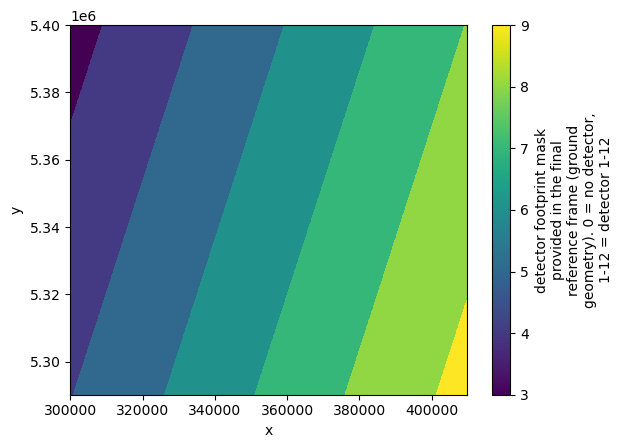

In [7]:
# Visualize detector footprint coverage at 60 m resolution (Band 09)
l1c_original["conditions"]["mask"]["detector_footprint"]["r60m"].b09.plot()

(Select_wave)=
## Selecting a Region and Verifying Detector Consistency

Wave spectrum analysis requires high resolution data. Thus we focus our analysis on 10 m spatial resolution band, such as B04 and B02, which are available in Sentinel-2 L1C products.

A 5 km × 5 km area of interest was manually selected using the UTM grid. To ensure accurate wave spectrum computation, we verify that the selected region in both bands corresponds to the same detector.

This verification step helps ensure consistency in viewing geometry. We also visualize the selected bands to inspect reflectance values before proceeding with spectral analysis.

Let's first define the area and try to plot the area on the map

In [8]:
# Define patch size in meters
size = 5000  # in meter

# Ocean location example:
west_utm = 352_305
south_utm = 5_345_005

# Bounding box corners
east_utm = west_utm + size
north_utm = south_utm + size

# Draw UTM bounding box using HoloViews
box = hv.Rectangles([(west_utm, south_utm, east_utm, north_utm)]).opts(
    line_color="white", line_width=1, fill_alpha=0
)

print("Selected UTM coordinates:", west_utm, south_utm, east_utm, north_utm)

# Overlay selected region on RGB quicklook
l1c_plot * box

Selected UTM coordinates: 352305 5345005 357305 5350005


:DynamicMap   []
   :Overlay
      .RGB.I        :RGB   [quality_l1c_quicklook_x,quality_l1c_quicklook_y]   (R,G,B)
      .Rectangles.I :Rectangles   [x0,y0,x1,y1]

### Clipping the dataset

Let's navigate to the 10 m spatial-resolution group at `["measurements"]["reflectance"]["r10m"]`, then clip the data to the bounding box defined above.

Once clipped, we name the 10 m resolution-band dataset `r10m`.

We will use this `r10m` dataset throughout the notebook.

```{note}
**Difference from SAFE workflow**  

For Level-1C and Level-2A, the granules, also called tiles, are 100x100km2 ortho-images in UTM(Universal Transverse Mercator) /WGS84 projection. The UTM 
In georeferenced *north-up* rasters the origin is the **upper-left**, so the vertical `y` coordinate in UTM grid is **descending** (values decrease downward). This is the usual convention for Sentinel-2 L1C SAFE products and is preserved in EOPF Zarr.  

With xarray’s `.sel`, the **slice order must match the coordinate order**. On a **descending** `y`, thus a standard `y=slice(south_utm, north_utm)` returns an empty selection. Use one of the following instead:

- method 1.  Selecting the image with original descending `y`: `y=slice(north_utm - 1, south_utm, 1)`  
    - Other possible way of selecting data is specify the image location using 'isel', in this case .isel(y=slice(5000,5500))
- method 2.  Swap the selection of `y` with interval as `-1`, to have the image stored with (0,0) element correspoinding to lower-left (South West).: `y=slice(south_utm, north_utm - 1, -1)`

The original workflow were decoding the image in south to north (method 2). To aligne with the original SAFE workflow, we select the image here using `y=slice(south_utm, north_utm - 1, -1)`

```


```{tip}
**When to call `.persist()`**

At this stage, we may choose to **call `.persist()`** when creating `r10m`.  
This tells Dask to load the data into distributed memory (**across workers**), which can significantly speed up repeated operations.

If we do **not** call `.persist()`, then each access will fetch the required chunks on demand.  
Since we know that `r10m` will be accessed multiple times (for visualisation and numerical analysis), in this workflow it makes sense to call `.persist()` now.

By contrast, calling `.load()` loads the data into your **local Jupyter process memory** (not into the Dask workers). If your workflow does not rely on Dask, `.load()` may be more appropriate.

Use `.persist()` or `.load()` only when the clipped subset fits comfortably in memory.  
If the dataset exceeds available memory, avoid persisting or loading to prevent exhausting your workers (with `.persist()`) or your Jupyter process (with `.load()`).
```


In [9]:
# Clip L1C to the box defined by west_utm/south_utm and east_utm/north_utm
# NOTE: y is descending (north-up), so we slice with a negative step.
l1c = l1c_original.sel(
    x=slice(west_utm, east_utm - 1), y=slice(south_utm, north_utm - 1, -1)
)

# Equivalent alternatives (kept here for reference):
# l1c = l1c_original.sel(x=slice(west_utm, east_utm - 1), y=slice(north_utm - 1, south_utm, 1))
# l1c = l1c_original.sel(x=slice(west_utm, east_utm - 1)).isel(y=slice(5000, 5500))

# Select the 10 m reflectance group as a Dataset, then persist if it fits in memory
r10m = l1c["measurements"]["reflectance"]["r10m"].to_dataset().persist()

# Quick sanity check with xarray’s Matplotlib integration
# r10m.b02.plot()

# (Optional) Compare array ordering with a raw Matplotlib image.
# Using .values forces a NumPy materialization; fine for small slices.
# plt.pcolormesh(r10m.b04.values, cmap="viridis"); plt.show()

### Visualise all 10 m bands

We visualise here **each variable** in `r10m` using xarray’s **hvplot** integration. (All xarray objects expose a `.hvplot` accessor for easy plotting.)

- Loop over `r10m.data_vars` and plot each band with `hvplot` using `x="x"` and `y="y"`.
- Set `aspect="equal"` so pixels are not distorted.
- Set `frame_width` to control panel size, and switch colormaps via `cmap`.
- Apply an ocean-themed, perceptually uniform colormap from **[cmocean](https://matplotlib.org/cmocean/)** (here `cmocean.cm.ice`) to keep patterns faithful while looking vibrant.
- Arrange the individual plots into a simple grid layout with two columns.

```{tip}
**Colour settings with hvPlot**

- `robust=True` auto-computes colour limits from the **2nd–98th percentiles**, which down-weights outliers for clearer quicklooks.
- For fair cross-band comparisons, use a **shared range**: compute `vmin, vmax` once (e.g., from 2–98% quantiles) and pass `clim=(vmin, vmax)`.  
  If `clim` is provided, it **overrides** `robust` and other automatic limits.
- If you enable `rasterize=True` later, you can choose Datashader **aggregators** such as:  
  `mean`, `sum`, `min`, `max`, `std`, `var`, `count`, `first`, `last`, `mode`.  
```

In [10]:
plots = [
    r10m[var].hvplot(
        x="x",
        y="y",
        aspect="equal",  # keep pixel aspect ratio 1:1 (no geometric distortion)
        cmap=cmocean.cm.ice,  # Choose a perceptually uniform, ocean-themed sequential colormap from cmocean
        title=f"{var}",
        frame_width=200,  # thumbnail size; increase if you want larger panels
        # robust=True,           # auto color limits from 2nd–98th percentiles
        # clim=(vmin, vmax),     # define vmin and vmax then uncomment to enforce the same range across bands
        # rasterize=True,        # render via Datashader for large arrays (fast pan/zoom)
        # aggregator="min",      # optional: choose Datashader aggregator; default is usually 'mean'
    )
    for var in r10m.data_vars
]


# Layout plots horizontally, then display as two columns
layout = plots[0]
for p in plots[1:]:
    layout += p
layout.cols(2)

:Layout
   .Image.I   :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b02 492.3 nm)
   .Image.II  :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b03 559.0 nm)
   .Image.III :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b04 665.0 nm)
   .Image.IV  :Image   [x,y]   (TOA reflectance from MSI acquisition at spectral band b08 833.0 nm)

### Detector Consistency Verification

Sentinel-2 MSI imagery is collected by **12 detectors**, each with slightly different viewing geometries.  
For accurate wave spectral analysis, it is essential that our cropped region comes from a **single detector** to ensure:

- Consistent viewing angles  
- Synchronized temporal sampling  
- Uniform spectral calibration  

Here we check whether all pixels in the clipped region belong to the same detector.

In [11]:
# Extract detector IDs over the clipped area (cast to int for clarity).
# Persist so the array is kept in Dask memory for faster repeated access.
b04_detector = (
    l1c["conditions"]["mask"]["detector_footprint"]["r10m"]["b04"].astype(int).persist()
)

# Take the detector ID from the first pixel as a reference value.
detector = int(b04_detector.isel(y=0, x=0).compute())

# Check whether all detector IDs in the clipped region match the reference.
if bool((b04_detector == detector).all().compute()):
    print(f"✅ Single detector confirmed: {int(detector)}")
else:
    # If not unique, count how many pixels belong to each detector.
    counts = b04_detector.groupby(b04_detector).count().rename("count").compute()
    raise ValueError(f"b04_detector is not unique! : {counts}")

✅ Single detector confirmed: 6


(Filter_wave)=
## Image Normalization and Whitecap Filtering

In this section, we **normalize the bands** and then apply an **edge-based filter** (Sobel + threshold) to reduce the influence of whitecaps (i.e., foam-related reflectance artefacts).

The original SAFE workflow used only two bands:
- **B04** (red)
- **B02** (blue)

With **xarray**, we can apply the same workflow in a simple and vectorised manner.  
Thanks to the **EOPF Zarr** format, this functionality is available natively—no extra complexity—so let’s apply the operations to **all `r10m` bands**.

### Median Normalization

We normalize each 10 m band in `r10m` by its **spatial median** (over `x` and `y`).  
This centers reflectance around ~1.0 and makes bands comparable for later filtering and spectra—no axis transposition needed.

In [12]:
# Normalize by median
normalised_r10 = r10m.apply(
    lambda da: da / np.nanmedian(da.values),
)
normalised_r10 = normalised_r10.persist()

### Sobel Filtering and Whitecap Masking

We apply a **Sobel** edge filter to each band to highlight intensity gradients (edges) typically associated with whitecaps or other strong reflectance structures, then mask pixels above each band’s **95th percentile** gradient.


Using xarray keeps the pipeline lazy: Sobel is applied via `apply(...)`, and thresholds use per-band `quantile(0.95)` so we avoid loading arrays eagerly.

```{tip}
**When to call `.persist()`**  


Here, we do **not** persist the intermediate `gradient_sobel` as it is computed only once.  But, 
we **do** persist the final `filtered_r10m` because it will be reused downstream (plots, spectra). 
```


```{tip}
For NumPy functions such as `func`, you can wrap them with  

`xr.apply_ufunc(func, data, dask="parallelized", vectorize=True, output_dtypes=[...])`  

to run lazily across Dask chunks and **parallelise** the computation.  
This pattern is especially useful when scaling to large datasets; in this notebook we don’t demonstrate it, since the example dataset is small.

```


In [13]:
# Apply the sobel operator
gradient_sobel = normalised_r10.apply(
    lambda da: sobel(da),
)
# gradient_sobel = gradient_sobel.persist() # we do not plot this value anywhere, so we keep it lazy (not compute here and triger the computation in later

# Threshold (95th percentile)
# Binary mask: retain only low-gradient (non-whitecap) regions
mask = gradient_sobel.apply(
    lambda da: da < np.percentile(da, 95),
)

# Apply mask: keep low-gradient (non-whitecap) pixels; drop high-gradient ones
filterd_r10m = (normalised_r10.where(mask, np.nan)).persist()
filterd_r10m

<xarray.Dataset> Size: 8MB
Dimensions:  (y: 500, x: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b03      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b04      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>
    b08      (y, x) float64 2MB dask.array<chunksize=(10, 260), meta=np.ndarray>

In [14]:
# Plot the filtered image

plots = [
    filterd_r10m[var].hvplot(
        x="x",
        y="y",
        aspect="equal",
        # rasterize=True,
        cmap=cmocean.cm.ice,  # alternatives: cmocean.cm.deep, cmocean.cm.thermal
        clim=(0.9, 1.1),  # normalized reflectance ~1
        colorbar=True,
        clabel="Normalised Image",
        title=f"Filtered — {var}",
        frame_width=200,
    )
    for var in filterd_r10m.data_vars
]

# Layout plots horizontally
layout = plots[0]
for p in plots[1:]:
    layout += p

layout.cols(2)

:Layout
   .Image.I   :Image   [x,y]   (b02)
   .Image.II  :Image   [x,y]   (b03)
   .Image.III :Image   [x,y]   (b04)
   .Image.IV  :Image   [x,y]   (b08)

### Pixel Value Distribution (Histogram)

We visualize the intensity distribution of the normalized reflectance values for bands using histograms. This step helps verify that the normalization behaves consistently across the two channels and that there are no outliers or saturation artifacts before spectral processing.

If it is a bimodial distribution, it may indicate the presense of clouds or other non wave related artifacts. 

In [15]:
# Display the histogram of values for the original image

plots = [
    normalised_r10[var].hvplot.hist(
        bins=100,
        #    color='blue',
        alpha=0.3,
        xlabel="Pixel Value",
        ylabel="Frequency",
        title="Histogramme intensity of each bands",
        frame_width=400,
    )
    for var in filterd_r10m.data_vars
]
combined_reversed = plots[-1]
for p in plots[-2::-1]:
    combined_reversed = combined_reversed * p

combined_reversed

:Overlay
   .NdOverlay.I   :NdOverlay   [Variable]
      :Histogram   [b08]   (Count)
   .NdOverlay.II  :NdOverlay   [Variable]
      :Histogram   [b04]   (Count)
   .NdOverlay.III :NdOverlay   [Variable]
      :Histogram   [b03]   (Count)
   .NdOverlay.IV  :NdOverlay   [Variable]
      :Histogram   [b02]   (Count)

(Welch_wave)=
## Fourier Transform & Welch-Based Spectral Analysis

This section demonstrates a two-dimensional Fast Fourier Transform (FFT) analysis on **paired Sentinel-2 images** (e.g., bands **B02** and **B04**). The core function, `FFT2D_two_arrays_nonan`, implements a **Welch-style spectral estimate** and is copy-pasted directly from the original research implementation.

What it does:
- **Image tiling:** The images are partitioned into overlapping tiles controlled by `ntile`.
- **NaN handling:** Within each tile, any NaNs (e.g., from filtering/masking) are replaced by the tile mean; tiles with >50% NaNs are skipped.
- **Windowing:** A 2-D **Hann** (a.k.a. “Hanning”) window is applied per tile to reduce edge artefacts and spectral leakage.
- **FFT per tile:** A 2-D FFT is computed for each windowed tile; power spectra are accumulated.
- **Welch averaging:** Spectra across tiles are averaged to stabilise estimates and reduce noise.

**Array orientation expected by the original function**  
`FFT2D_two_arrays_nonan(arraya, arrayb, dx, dy, n, ...)` expects **NumPy arrays** (`arraya` and `arrayb`) with the **first dimension = `x` (west→east)** and the **second dimension = `y` (south→north)**.  
EOPF Zarr exposes bands with dimensions ordered as **(`y`, `x`)**, so we **transpose** to `("x","y")` before calling the function.

**Outputs**
- `Eta`, `Etb`: power spectral densities (PSDs) of each image  
- `coh`: spectral coherence between the two images  
- `ang`: phase difference (radians)  
- `crosr`: real part of the cross-spectrum  
- `kx2`, `ky2`: spatial frequency coordinates (cycles per metre)  
- `dkxtile`, `dkytile`: frequency resolution (x and y)



```{note}
**Reusing SAFE-era functions with EOPF Zarr**

When calling Python code developed for SAFE inputs, be explicit about the **array orientation** that the function expects. Even though EOPF Zarr preserves the SAFE north-up storage, some SAFE workflows **reordered** arrays before analysis.

Once you’ve verified the expected order, reusing your function is straightforward: convert the xarray DataArray to a NumPy array in the right orientation, e.g.

```python
arraya = filterd_r10m_transposed["b04"].compute().values
```



In [16]:
# Transpose Dataset so each band is (x, y) to match function expectations
# (EOPF Zarr typically exposes (y, x); we make it explicit here.)
filterd_r10m_transposed = filterd_r10m.transpose("x", "y")
filterd_r10m_transposed

<xarray.Dataset> Size: 8MB
Dimensions:  (y: 500, x: 500)
Coordinates:
  * x        (x) int64 4kB 352305 352315 352325 352335 ... 357275 357285 357295
  * y        (y) int64 4kB 5345005 5345015 5345025 ... 5349975 5349985 5349995
Data variables:
    b02      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b03      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b04      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>
    b08      (x, y) float64 2MB dask.array<chunksize=(260, 10), meta=np.ndarray>

In [17]:
def FFT2D_two_arrays_nonan(arraya, arrayb, dx, dy, n, isplot=0):
    # Welch-based 2D spectral analysis
    # nxa, nya : size of arraya
    # dx, dy : resolution of arraya
    # n : number of tiles in each direction

    [nxa, nya] = np.shape(arraya)
    mspec = n**2 + (n - 1) ** 2
    nxtile = int(np.floor(nxa / n))
    nytile = int(np.floor(nya / n))

    dkxtile = 1 / (dx * nxtile)
    dkytile = 1 / (dy * nytile)

    shx = int(nxtile // 2)  # OK if nxtile is even number
    shy = int(nytile // 2)

    # --- Prepare wavenumber vectors ---
    kx = np.fft.fftshift(np.fft.fftfreq(nxtile, dx))
    ky = np.fft.fftshift(np.fft.fftfreq(nytile, dy))
    kx2, ky2 = np.meshgrid(kx, ky, indexing="ij")

    if isplot:
        X = np.arange(0, nxa * dx, dx)
        Y = np.arange(0, nya * dy, dy)

    # --- Prepare Hanning windows ---
    hanningx = 0.5 * (
        1 - np.cos(2 * np.pi * np.linspace(0, nxtile - 1, nxtile) / (nxtile - 1))
    )
    hanningy = 0.5 * (
        1 - np.cos(2 * np.pi * np.linspace(0, nytile - 1, nytile) / (nytile - 1))
    )
    hanningxy = np.atleast_2d(hanningy) * np.atleast_2d(hanningx).T

    wc2x = 1 / np.mean(hanningx**2)
    wc2y = 1 / np.mean(hanningy**2)
    normalization = (wc2x * wc2y) / (dkxtile * dkytile)

    # --- Initialize ---
    Eta = np.zeros((nxtile, nytile))
    Etb = np.zeros((nxtile, nytile))
    phase = np.zeros((nxtile, nytile), dtype=np.complex128)
    phases = np.zeros((nxtile, nytile, mspec), dtype=np.complex128)

    if isplot:
        fig1, ax1 = plt.subplots(figsize=(12, 6))
        ax1.pcolormesh(X, Y, arraya)
        # colors = plt.cm.seismic(np.linspace(0, 1, mspec))

    # --- Calculate spectrum for each tile ---
    nspec = 0
    for m in range(mspec):
        if m < n**2:
            i1 = int(np.floor(m / n) + 1)
            i2 = int(m + 1 - (i1 - 1) * n)

            ix1, ix2 = nxtile * (i1 - 1), nxtile * i1 - 1
            iy1, iy2 = nytile * (i2 - 1), nytile * i2 - 1
        else:
            i1 = int(np.floor((m - n**2) / (n - 1)) + 1)
            i2 = int(m + 1 - n**2 - (i1 - 1) * (n - 1))

            ix1, ix2 = nxtile * (i1 - 1) + shx, nxtile * i1 + shx - 1
            iy1, iy2 = nytile * (i2 - 1) + shy, nytile * i2 + shy - 1

        array1 = np.array(arraya[ix1 : ix2 + 1, iy1 : iy2 + 1], dtype=np.float64)
        array2 = np.array(arrayb[ix1 : ix2 + 1, iy1 : iy2 + 1], dtype=np.float64)

        # **Gestion des NaN**
        mask1 = np.isnan(array1)
        mask2 = np.isnan(array2)

        # Remplacement des NaN par la moyenne locale
        if np.any(mask1):
            array1[mask1] = np.nanmean(array1)
        if np.any(mask2):
            array2[mask2] = np.nanmean(array2)

        # Ignorer les tuiles avec trop de NaN (ex: >50% de la tuile)
        if np.sum(mask1) > 0.5 * array1.size or np.sum(mask2) > 0.5 * array2.size:
            continue

        # **Application de la fenêtre de Hanning en tenant compte des NaN**
        valid_mask1 = (~mask1).astype(float)
        valid_mask2 = (~mask2).astype(float)

        tile_centered = (array1 - np.nanmean(array1)) * valid_mask1
        tile_by_windows = tile_centered * hanningxy
        tileFFT1 = np.fft.fft2(tile_by_windows, norm="forward")
        tileFFT1_shift = np.fft.fftshift(tileFFT1)
        Eta += (abs(tileFFT1_shift) ** 2) * normalization

        tile_centered = (array2 - np.nanmean(array2)) * valid_mask2
        tile_by_windows = tile_centered * hanningxy
        tileFFT2 = np.fft.fft2(tile_by_windows, norm="forward")
        tileFFT2_shift = np.fft.fftshift(tileFFT2)
        Etb += (abs(tileFFT2_shift) ** 2) * normalization

        phase += tileFFT2_shift * np.conj(tileFFT1_shift) * normalization
        nspec += 1
        phases[:, :, m] = (
            tileFFT2_shift
            * np.conj(tileFFT1_shift)
            / (abs(tileFFT2_shift) * abs(tileFFT1_shift))
        )

    # **Rotation des phases autour de la moyenne**
    for m in range(mspec):
        phases[:, :, m] /= phase

    # **Normalisation finale**
    Eta /= nspec
    Etb /= nspec
    coh = abs((phase / nspec) ** 2) / (Eta * Etb)  # spectral coherence
    ang = np.angle(phase, deg=False)
    crosr = np.real(phase) / mspec
    angstd = np.std(np.angle(phases, deg=False), axis=2)

    return Eta, Etb, ang, angstd, coh, crosr, phases, kx2, ky2, dkxtile, dkytile


##############################################################################

# Pixel size in metres (Sentinel-2 10 m bands)
dx = dy = 10
ntile = 16
# Pass filtered images as NumPy arrays in (x, y) order
arraya = filterd_r10m_transposed["b04"].compute().values
arrayb = filterd_r10m_transposed["b02"].compute().values

(Eta, Etb, ang, angstd, coh, crosr, phases, kx2, ky2, dkx, dky) = (
    FFT2D_two_arrays_nonan(arraya, arrayb, dx, dy, ntile, isplot=0)
)

(Cross_wave)=
## 🌊 Fourier and Cross-Spectral Analysis with angular metrics.

With the Welch-based spectral analysis in place, the next step is to visualizes to analyzes spatial and spectral properties of satellite image data.  To do so we need first to compute viewing geometry.   


### Computing Viewing Geometry : Sun and View Angles 🌞 📐 

We want to extract sun and viewing angles from the Sentinel-2 L1C data product and compute relevant angular quantities such as phase angles or off-specular angles. These metrics help understand the scattering geometry at the selected region (e.g., for ocean wave analysis).

#### Accessing the Angle Data  🌞 

The full datatree contains the geometry metadata at this location ['conditions']['geometry']:
Angle layers may be provided at different native resolutions (e.g., `r10m`, `r20m`, `r60m`). We will visualise them and then sample the angles at the **centre** of our clipped region.



```{tip}
**Interactive sliders with hvPlot** 

For xarray data, `hvplot(..., groupby=...)` adds widgets (sliders/dropdowns) for non-spatial dimensions (e.g., `angle`, `detector`, `band`) while `x="x"`, `y="y"` define the map axes.
```

In [18]:
(
    l1c_original["conditions"]["geometry"]["sun_angles"].hvplot(
        x="x",
        y="y",
        aspect="equal",
        frame_width=200,
    )
    + l1c_original["conditions"]["geometry"]["viewing_incidence_angles"].hvplot(
        x="x",
        y="y",
        aspect="equal",
        frame_width=200,
    )
).cols(1)

:Layout
   .DynamicMap.I  :DynamicMap   [angle]
      :Image   [x,y]   (sun_angles)
   .DynamicMap.II :DynamicMap   [detector,band,angle]
      :Image   [x,y]   (viewing_incidence_angles)

In [19]:
sun_angles = l1c["conditions"]["geometry"]["sun_angles"]
view_angles = l1c["conditions"]["geometry"]["viewing_incidence_angles"]
print("sun_angle:", sun_angles.compute().values)
print(
    "view_angle:",
    view_angles.sel(detector=detector, band=["b02", "b04"]).compute().values,
)

sun_angle: [[[ 27.0145]]

 [[152.472 ]]]
view_angle: [[[[ 1.13787]]

  [[89.3232 ]]]


 [[[ 1.38971]]

  [[67.2367 ]]]]


Since we’ve already clipped the image for our region of interest, we only extract the angles for this subset. However, the sampling grid might not be perfectly centered, so we need to interpolate the angle fields at the center of our clipped region.

The Center of the Clipped Region is: 


In [20]:
x_val = (west_utm + east_utm) / 2
y_val = (south_utm + north_utm) / 2
print(x_val, y_val)

354805.0 5347505.0


But in our case, it is slightly be off the center of our image.  So let's get it interpolated. 

####  Interpolating and Analyzing Viewing Geometry from Sentinel-2 L1C Data
To extract sun and viewing angles at a specific location in the scene, convert them to Cartesian unit vectors, and compute derived angular metrics for scattering geometry analysis.

 Interpolating Angles at Arbitrary `(x, y)` Coordinates

In [21]:
def interpolate_angles_at_xy(x_val, y_val, angle_array):
    """
    Interpolate azimuth and zenith angles at (x, y) coordinates.

    Parameters:
        x_val (float): x coordinate
        y_val (float): y coordinate
        angle_array (xarray.DataArray): must have 'angle' dimension with 'zenith' and 'azimuth'

    Returns:
        xarray.DataArray: Interpolated angle array with dimensions (band, detector, angle)
    """
    angle_names = angle_array.angle.values
    if "azimuth" not in angle_names or "zenith" not in angle_names:
        raise ValueError("Missing 'azimuth' or 'zenith' in angle dimension.")

    zenith = angle_array.sel(angle="zenith").interp(x=x_val, y=y_val)
    azimuth = angle_array.sel(angle="azimuth")
    sin_az = np.sin(np.deg2rad(azimuth))
    cos_az = np.cos(np.deg2rad(azimuth))
    interp_sin = sin_az.interp(x=x_val, y=y_val)
    interp_cos = cos_az.interp(x=x_val, y=y_val)
    azimuth_corrected = (np.rad2deg(np.arctan2(interp_sin, interp_cos))) % 360

    result = xr.concat(
        [
            zenith.expand_dims(angle=["zenith"]),
            azimuth_corrected.expand_dims(angle=["azimuth"]),
        ],
        dim="angle",
    )
    return result


view_angles = interpolate_angles_at_xy(
    x_val, y_val, l1c_original["conditions"]["geometry"]["viewing_incidence_angles"]
)
sun_angles = interpolate_angles_at_xy(
    x_val, y_val, l1c_original["conditions"]["geometry"]["sun_angles"]
)
sun_angles.compute().values, view_angles.sel(
    detector=detector, band=["b02", "b04"]
).compute().values

(array([ 26.99460189, 152.45104   ]),
 array([[ 1.09648737,  1.35688407],
        [88.6205506 , 65.99286503]]))

####  Computes angular metrics comparable to the original Sentinel‑2 SAFE/SAFE2 XML‑based code, using Zarr format and xarray:

1.	Spherical to Cartesian Conversion
Convert interpolated zenith and azimuth angles (sun and view) into unit vectors:
sunvec = sph2cart(sun_angles) and obsvec = sph2cart(view_angles).

2.	Mid-Vector Calculation
Sum and normalize the two direction vectors to obtain the mid-vector (midvec_norm) between sensor and sun hemispheres.

3.	Derived Metrics
Compute three angular metrics essential for scattering analysis:
    - offspec: Off‑specular angle = angle between mid‑vector and vertical
    - phitrig: Azimuth of mid‑vector (used to overlay blind azimuths on k‑space)
    - thetav: Sensor view zenith angle
    
4.	Selection for Specific Band & Detector
Choose the relevant subset for a given detector and bands (e.g. B04 and B02):


In [22]:
def sph2cart(angle_da):
    """
    Convert spherical angles to Cartesian unit vectors.

    Parameters:
        angle_da (xarray.DataArray): must have 'angle' = ['zenith', 'azimuth']

    Returns:
        xarray.DataArray: shape (..., cartesian) with cartesian = ['x', 'y', 'z']
    """
    theta = np.radians(angle_da.sel(angle="zenith"))
    phi = np.radians(angle_da.sel(angle="azimuth"))
    x = np.sin(theta) * np.sin(phi)
    y = np.sin(theta) * np.cos(phi)
    z = np.cos(theta)
    return xr.concat([x, y, z], dim="cartesian").assign_coords(
        cartesian=["x", "y", "z"]
    )


# Compute Cartesian vectors
sunvec = sph2cart(sun_angles)
obsvec = sph2cart(view_angles)
# 🔄 Mid-Vector and Normalization
midvec = obsvec + sunvec
midvec_norm = midvec / np.sqrt((midvec**2).sum("cartesian"))
# 📐 Angular Metrics Computation
offspec = np.degrees(np.arccos(midvec_norm.sel(cartesian="z")))
phitrig = np.degrees(
    np.arctan2(midvec_norm.sel(cartesian="x"), midvec_norm.sel(cartesian="y"))
)
thetav = np.degrees(np.arccos(obsvec.sel(cartesian="z")))
phitrig = phitrig.sel(detector=6, band=["b04", "b02"]).compute()
phitrig

<xarray.DataArray (band: 2)> Size: 16B
array([149.47993192, 150.32367791])
Coordinates:
  * band      (band) <U3 24B 'b04' 'b02'
    detector  int64 8B 6
    x         float64 8B 3.548e+05
    y         float64 8B 5.348e+06
    angle     <U6 24B 'zenith'

#### Blind Azimuth Vectors in Fourier Space

This section overlays directional markers in Fourier space (**k‑space**) to emphasize **blind azimuth angles**—directions in which specular reflection (sunglint) is minimized. These are useful for interpreting wave fields in optical imagery, especially when bright reflections mask fine patterns.

Waves propagating along these **blind directions** are expected to produce minimal brightness modulation due to the geometry of sun-sensor alignment, making them harder to detect.

To compute and overlay these directions:

- **`phitrig[b]`** is the azimuth angle (in degrees) of the **mid-vector** between the sun and sensor directions, previously computed for each band *b*.
- The **blind azimuth direction** is calculated as:
  ```python
  phiblind = phitrig + 90
   ```
  This is orthogonal to the mid-vector, i.e., the direction where sunglint is minimized.
- k-space overlay vectors are then defined as:
  ```python
  ±1.4 * kN * [sin(phiblind), cos(phiblind)]  
  ```
  where:
  - kN = 50 is a manual scaling factor to make the vectors visually prominent in spectral plots.
  - The ± sign draws symmetric vectors in both directions.

These vectors are plotted as dashed lines on 2D spectral maps (e.g., power, coherence, phase) to visualize and assess whether wave energy aligns with or avoids these blind azimuth directions.

This visualization is especially helpful to confirm directional biases in wave energy related to illumination and viewing geometry.


In [23]:
# Compute blind azimuth:
phiblind1 = phitrig[0].values + 90.0  # blind azimuth for B04
phiblind2 = phitrig[1].values + 90.0  # blind azimuth for B02
kN = 50
xkblind = [
    -1.4 * kN * np.sin(np.radians(phiblind1)),
    1.4 * kN * np.sin(np.radians(phiblind2)),
]
ykblind = [
    -1.4 * kN * np.cos(np.radians(phiblind1)),
    1.4 * kN * np.cos(np.radians(phiblind2)),
]
print(xkblind, ykblind)

[60.30159381316901, -60.81853346026498] [35.54880846936472, -34.65697603286573]


## Physical Interpretation of Results

Let's analyse the result of Fourier and Cross-Spectral with angular metrics and understand the result.


We will first compute  Variance and Energy Check, then make 4 different set of plots and make interpretation.  



### 0. 🧮 Variance and Energy Check
- Compares spatial domain variance to spectral energy.
- A consistency check based on Parseval's theorem.


In [24]:
# Parseval/variance checks
print("variance B04:", np.nanvar(arraya), "sum of spectrum:", np.sum(Eta) * dkx * dky)
print("variance B02:", np.nanvar(arrayb), "sum of spectrum:", np.sum(Etb) * dkx * dky)

variance B04: 0.004539154168472143 sum of spectrum: 0.003969145049406069
variance B02: 0.0006660525439104757 sum of spectrum: 0.0005955796139226746


### 1. 🖼️ Surface Image Plot
- **What we see**: Filtered Sentinel-2 B04 reflectance showing ocean wave patterns
- **Preprocessing**: Whitecaps removed, median normalized, edge effects minimized
- **Scale**: 5×5 km region with 10m pixel resolution
- **Pattern**: Clear wave trains visible as brightness variations

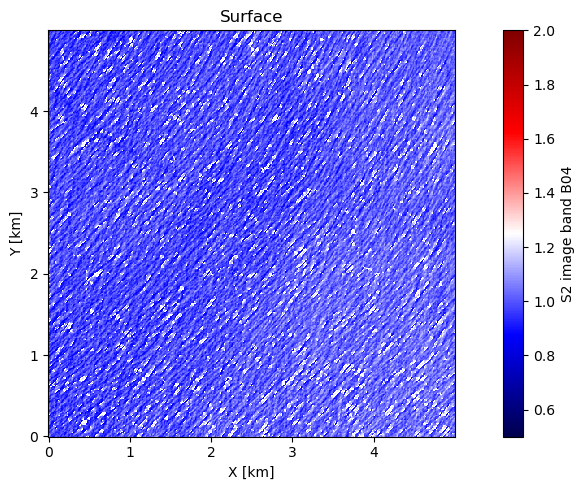

In [25]:
# 1) Surface image (B04)

# Grid from the filtered dataset
(ny, nx) = filterd_r10m["b04"].shape
X = np.arange(0, nx * dx, dx)  # [m]
Y = np.arange(0, ny * dy, dy)

fig, ax = plt.subplots(figsize=(10, 5))
ax.set_aspect("equal", adjustable="box")
im = ax.pcolormesh(
    X / 1000,
    Y / 1000,
    filterd_r10m["b04"].values,
    cmap="seismic",
    norm=mcolors.Normalize(vmin=0.5, vmax=2),
)
plt.colorbar(im, ax=ax, label="S2 image band B04")
ax.set_xlabel("X [km]")
ax.set_ylabel("Y [km]")
ax.set_title("Surface")
plt.tight_layout()

### 2. 📊 Power Spectrum Plot  
- **What we see**: 2D Fourier transform revealing dominant wave directions
- **Axes**: Spatial frequency (cycles/km) in X and Y directions
- **Interpretation**: 
  - Bright regions = dominant wave energy
  - Peak locations = wavelength and direction
  - Dashed line = satellite viewing geometry (blind direction)
- **Key Finding**: Energy concentrated in NW-SE direction, indicating swell propagation

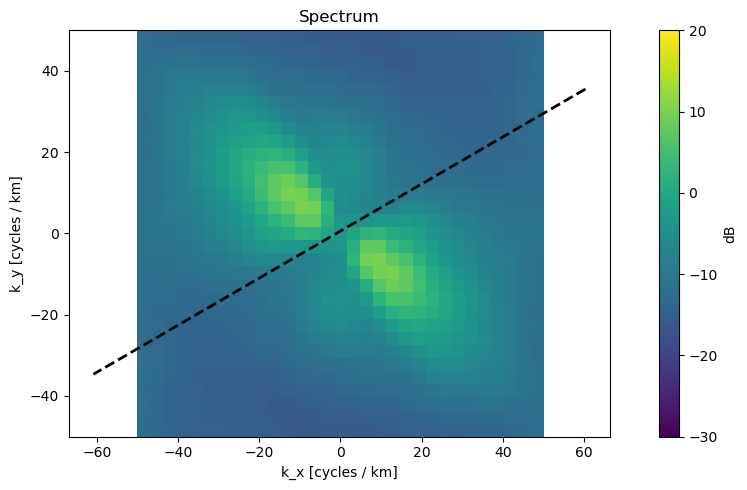

In [26]:
# 2) Spectrum (Eta) in dB
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_aspect("equal", adjustable="box")
im = ax.pcolormesh(
    kx2 * 1000,
    ky2 * 1000,
    10 * np.log10(Eta),
    norm=mcolors.Normalize(vmin=-30, vmax=20),
)
plt.colorbar(im, ax=ax, label="dB")
ax.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
ax.set_xlabel("k_x [cycles / km]")
ax.set_ylabel("k_y [cycles / km]")
ax.set_title("Spectrum")
plt.tight_layout()

### 3. 🔗 Coherence Map 
- **What we see**: Correlation between B02 and B04 bands in frequency space
- **Values**: 0 (random noise) to 1 (perfect correlation)
- **Interpretation**:
  - High coherence (yellow) = real wave signals
  - Low coherence (blue) = instrumental noise or artifacts
- **Quality Metric**: Coherence >0.7 indicates reliable wave measurements


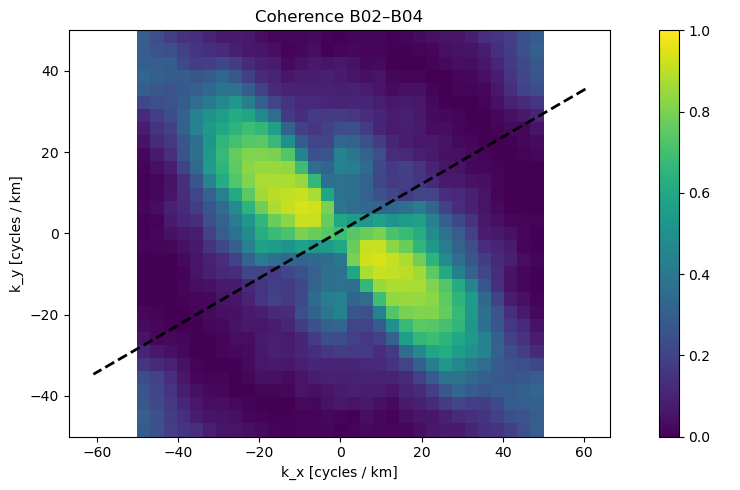

In [27]:
# 3-1) Coherence
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_aspect("equal", adjustable="box")
im = ax.pcolormesh(
    kx2 * 1000,
    ky2 * 1000,
    coh,
    norm=mcolors.Normalize(vmin=0, vmax=1),
)
plt.colorbar(im, ax=ax, label=" ")
ax.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
ax.set_xlabel("k_x [cycles / km]")
ax.set_ylabel("k_y [cycles / km]")
ax.set_title("Coherence B02–B04")
plt.tight_layout()

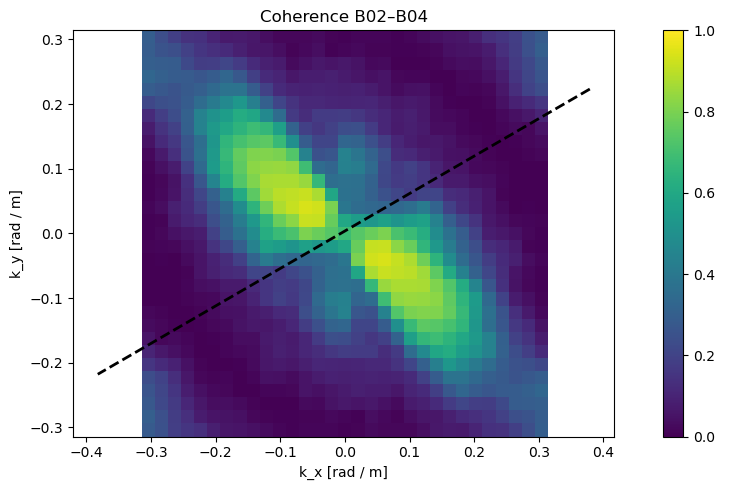

In [28]:
# 3-2) Coherence (rad/m axes)
# convert xkblind, ykblind from cycles/km  → rad/m
def to_radm(seq):
    fact = 2 * np.pi / 1000.0
    if (
        isinstance(seq, (list, tuple))
        and len(seq) > 0
        and isinstance(seq[0], (list, tuple, np.ndarray))
    ):
        return [np.asarray(s, dtype=float) * fact for s in seq]
    return np.asarray(seq, dtype=float) * fact


xkblind_radm = to_radm(xkblind)
ykblind_radm = to_radm(ykblind)


fig, ax = plt.subplots(figsize=(10, 5))
ax.set_aspect("equal", adjustable="box")
im = ax.pcolormesh(
    kx2 * 2 * np.pi,
    ky2 * 2 * np.pi,
    coh,
    norm=mcolors.Normalize(vmin=0, vmax=1),
)
plt.colorbar(im, ax=ax, label=" ")
ax.plot(xkblind_radm, ykblind_radm, color="k", linestyle="--", linewidth=2)

ax.set_xlabel("k_x [rad / m]")
ax.set_ylabel("k_y [rad / m]")
ax.set_title("Coherence B02–B04")
plt.tight_layout()

### 4. 🔄 Cross-Spectrum Phase Difference 
This Cross-Spectrum is using the time lag between B02 and B04 acquisitions.   

- **What we see**:  Phase angle of the cross-spectrum between two bands.
 Indicates relative shifts between features in different spectral bands.
- **Physical Meaning**: Wave propagation direction and speed
- **Color Scale**: ±180 degrees phase difference
- **Key Insight**: 
  - Positive phase (red) in NW quadrant
  - Negative phase (blue) in SE quadrant
  - **Indicates waves moving from NW to SE during 1-second B02-B04 delay **

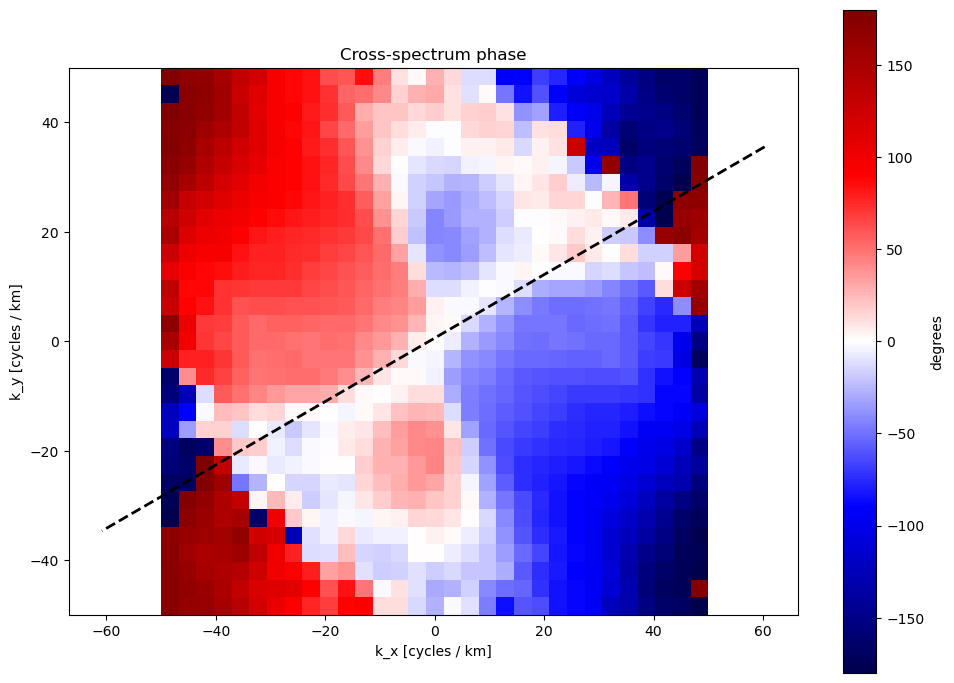

In [29]:
# 4) Cross-spectrum phase (degrees)
fig, ax = plt.subplots(figsize=(10, 7))
ax.set_aspect("equal", adjustable="box")
im = ax.pcolormesh(
    kx2 * 1000,
    ky2 * 1000,
    np.degrees(ang),
    cmap="seismic",
    norm=mcolors.Normalize(vmin=-180, vmax=180),
)
plt.colorbar(im, ax=ax, label="degrees")
ax.plot(xkblind, ykblind, color="k", linestyle="--", linewidth=2)
ax.set_xlabel("k_x [cycles / km]")
ax.set_ylabel("k_y [cycles / km]")
ax.set_title("Cross-spectrum phase")
plt.tight_layout()

### Scientific Significance

This analysis reveals:

1. **Wave Direction**: NW-SE propagation consistent with Atlantic swell patterns
2. **Wave Quality**: High coherence confirms reliable measurements using EOPF datasets
3. **Propagation Speed**: Phase gradient indicates ~15-20 m/s wave celerity
4. **Methodology Validation**: Results consistent with expected oceanographic conditions published in the Bay of Biscay ([**See Link to the WW3 simulation website**](https://marc.ifremer.fr/resultats/vagues/modeles_atlantique_nord/(variable)/hs/(typevisu)/map/(zoneid)/7148/(type)/canvas#appTop)).

```{note}
The coherence values above 0.7 in specific frequency bands indicate that the EOPF ZARR workflow successfully preserves the signal quality needed for quantitative wave analysis.

(Summary_wave)=
## Summary 
This script performs comprehensive spectral analysis of satellite imagery by:

- Visualizing filtered spatial data
- Computing 2D Fourier spectra
- Quantifying inter-band similarity via coherence and cross-spectral phase
- Evaluating energy consistency between spatial and spectral domains

It is especially useful in oceanographic but also  Earth surface pattern studies (e.g., wave fields, vegetation patterns, surface roughness).

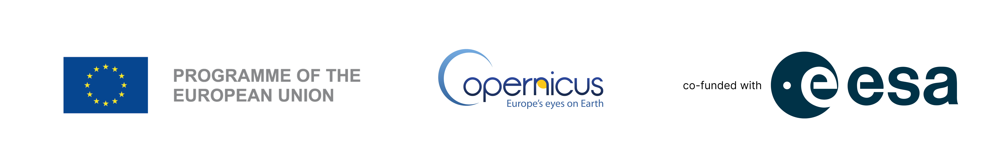